<a href="https://colab.research.google.com/github/xArtu/Big-Data/blob/main/Copia_de_tutorial_segmentacion_con_YOLOv11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# TUTORIAL: SEGMENTACIÓN DE INSTANCIAS CON YOLO 11

En este tutorial veremos cómo usar un set de imágenes propio para afinar el modelo YOLO11 (la versión más reciente de Ultralytics) para realizar una tarea de segmentación de instancias de objetos.

Contenido:

1. ¿Qué es YOLO11?
2. Tipos de segmentación (de instancias vs. semántica)
3. Objetivo del tutorial
4. Preparación del dataset
5. Afinación de YOLO11 (segmentación de instancias) con el dataset
6. Generación de predicciones con el modelo afinado

## 1. ¿Qué es YOLO11?

YOLO11 es la última versión del modelo de detección de objetos de Ultralytics que permite realizar tareas como la detección de objetos, segmentación de instancias y la estimación de poses entre otras:

![](https://raw.githubusercontent.com/ultralytics/assets/main/im/banner-tasks.png)

Esta nueva versión ofrece cinco tamaños de modelo: Nano, Small, Medium, Large y X.

## 2. Tipos de segmentación (de instancias vs. semántica)

![](https://corrosionsegmenter.com/static/Homepage_photos/Semantic_vs_instance.jpg)

- Segmentación de instancias: la idea es **identificar y delinear cada objeto en una imagen** (ejemplo: fondo, persona 1, persona 2,...)
- Segmentación semántica: categoriza los pixeles de una imagen en diferentes clases (ejemplo: fondo, persona)

## 3. Objetivo del tutorial

En este tutorial veremos cómo afinar el modelo YOLO11 para realizar segmentación de instancias usando un dataset propio.

En el caso de YOLO11 la salida (predicción) hecha por el modelo contendrá tres elementos:

- Las máscaras (contornos) the cada objeto
- La categoría de cada objeto
- Las probabilidades asociadas a cada objeto

![](https://cdn.prod.website-files.com/6479eab6eb2ed5e597810e9e/6729fecc79bc58a68880f373_6729fd101d9e509019292e2a_Segmentation_Fig%25201.png)

## 4. Preparación del dataset

Al igual que ocurrió con el tutorial de detección de objetos, según la documentación de Ultralytics, el set de imágenes debe estar estructurado de esta manera:

![](https://github.com/ultralytics/docs/releases/download/0/two-persons-tie-2.avif)

Además, los modelos disponibles son los siguientes:

![](https://drive.google.com/uc?export=view&id=1SrOta15xyyMYYX7w_8Ey9GtVYDRQY0Jo)

En este caso usaremos el modelo más pequeño (YOLO11n-seg) con 2.9 millones de parámetros.

Al igual que con la detección de objetos, en este caso se debe garantizar que la dimensión más grande a usar en las imágenes sea de 640 pixeles.

Estos son los pasos para tener disponible el set de datos desde Google Colab:

1. Primero debemos crear la carpeta "datasets" en el directorio "content" de Google Colab
2. Ahora descargamos el set de datos desde [este enlace](https://drive.google.com/file/d/1seDEH32VjgCshHJsG2i8L-sG6PNDeT7Y/view?usp=sharing).
3. Una vez descargado el archivo "dataset_masas_agua.zip" lo llevamos a la carpeta "datasets" de Google Colab
4. Ahora descomprimimos el archivo .zip:

In [1]:
from google.colab import drive
drive.mount('/content/drive')

# Configurar rutas (ajusta según tu estructura)
dataset_path = "/content/drive/MyDrive"

Mounted at /content/drive


In [2]:
# prompt: Extrae el contenido de /content/drive/MyDrive/YOLODataset.zip en Collab

!unzip /content/drive/MyDrive/datasets.zip -d /content/datasets


Archive:  /content/drive/MyDrive/datasets.zip
   creating: /content/datasets/labels/
  inflating: /content/datasets/__MACOSX/._labels  
  inflating: /content/datasets/labels/aug_119_4_img-281.txt  
  inflating: /content/datasets/__MACOSX/labels/._aug_119_4_img-281.txt  
  inflating: /content/datasets/labels/aug_98_3_img-257.txt  
  inflating: /content/datasets/__MACOSX/labels/._aug_98_3_img-257.txt  
  inflating: /content/datasets/labels/aug_42_0_frame_0168.txt  
  inflating: /content/datasets/__MACOSX/labels/._aug_42_0_frame_0168.txt  
  inflating: /content/datasets/labels/aug_33_4_img-255.txt  
  inflating: /content/datasets/__MACOSX/labels/._aug_33_4_img-255.txt  
  inflating: /content/datasets/labels/aug_87_2_frame_0167.txt  
  inflating: /content/datasets/__MACOSX/labels/._aug_87_2_frame_0167.txt  
  inflating: /content/datasets/labels/aug_142_3_img-120.txt  
  inflating: /content/datasets/__MACOSX/labels/._aug_142_3_img-120.txt  
  inflating: /content/datasets/labels/aug_110_0_im

In [3]:
!rm -rf /content/datasets/__MACOSX/

In [4]:
# prompt: Dime cuantos elementos existen en images y en labels

import os

# Define the paths to your images and labels directories.
# Adjust these paths if your dataset is structured differently.
images_path = "/content/datasets/images"
labels_path = "/content/datasets/labels"

# Count the number of image files.
num_images = 0
if os.path.exists(images_path):
  for filename in os.listdir(images_path):
    if os.path.isfile(os.path.join(images_path, filename)):
        num_images += 1

# Count the number of label files
num_labels = 0
if os.path.exists(labels_path):
  for filename in os.listdir(labels_path):
      if os.path.isfile(os.path.join(labels_path, filename)):
          num_labels += 1


print(f"Number of images: {num_images}")
print(f"Number of labels: {num_labels}")


Number of images: 462
Number of labels: 462


In [5]:
# prompt: Divide las imagenes de la siguiente forma, images debe tener las carpetas de train, val, test. Lo mismo con labels para poder entrenar a yolo, distribuye los datos con la siguiente estimación
# 1.800 imágenes de entrenamiento
# 386 imágenes de validación
# 385 imágenes de prueba
# tomando en cuenta que aquí solo hay 462

import os
import random
import shutil

# Define paths
dataset_path = "/content/datasets"
images_path = os.path.join(dataset_path, "images")
labels_path = os.path.join(dataset_path, "labels")

# Create output directories
output_dir = os.path.join(dataset_path, "output")
os.makedirs(output_dir, exist_ok=True)
for split in ["train", "val", "test"]:
    os.makedirs(os.path.join(output_dir, "images", split), exist_ok=True)
    os.makedirs(os.path.join(output_dir, "labels", split), exist_ok=True)

# Get image and label filenames
image_files = [f for f in os.listdir(images_path) if f.endswith(('.jpg', '.jpeg', '.png'))]
label_files = [f for f in os.listdir(labels_path) if f.endswith('.txt')]

# Filter out labels without matching images
label_files = [label for label in label_files if label[:-4] + ".jpg" in image_files or label[:-4] + ".jpeg" in image_files or label[:-4] + ".png" in image_files ]


# Shuffle data
combined = list(zip(image_files, label_files))
random.shuffle(combined)
image_files, label_files = zip(*combined)


# Calculate split indices
total_images = len(image_files)
train_split = int(0.8 * total_images)  # 80% for training
val_split = int(0.9 * total_images)     # 10% for validation
test_split = total_images              # remaining 10% for testing

# Distribute images and labels into train, val, and test sets
splits = {
    "train": (0, train_split),
    "val": (train_split, val_split),
    "test": (val_split, total_images)
}

for split, (start, end) in splits.items():
    for i in range(start, end):
        image_file = image_files[i]
        label_file = label_files[i]

        # Copy files to the corresponding split directories
        shutil.copy(os.path.join(images_path, image_file), os.path.join(output_dir, "images", split, image_file))
        shutil.copy(os.path.join(labels_path, label_file), os.path.join(output_dir, "labels", split, label_file))

print("Dataset split and copied successfully!")


Dataset split and copied successfully!


In [6]:
!rm -rf /content/datasets/images/

In [7]:
!rm -rf /content/datasets/labels/

In [8]:
!mv /content/datasets/output/images /content/datasets/images
!mv /content/datasets/output/labels /content/datasets/labels

In [9]:
!rm -rf /content/datasets/output/

Y finalmente podemos eliminar el archivo .zip.

Verifiquemos que la estructura del set de datos es la especificada en la documentación de Ultralytics.

En total tendremos:

- 1.800 imágenes de entrenamiento
- 386 imágenes de validación
- 385 imágenes de prueba

Además, por cada imagen tendremos una etiqueta correspondiente. Esta etiqueta es un archivo que contiene el mismo nombre de la imagen y ubicado en la carpeta "labels".

Acá un ejemplo de uno de estos archivos:


```
0 0.019479016674635 0.7572807397597392 0.9565207544322961 0.4137902387902038 0.06623552144808464 0.5769703296820713 0.12919378369042364 0.9204608306516067
0 0.6629320682248917 0.4815050417651926 0.6532378519418947 0.4056399442394203 0.13368551666520592 0.4720295340873393 0.14337973294820294 0.5478946316131116
0 0.985838495598216 0.3716796759791363 0.9691616340673997 0.3158526156542626 0.6188318501402568 0.42050439675602724 0.6355087116710729 0.476331457080901
0 0.13512469227236049 0.476852626613488 0.13159425851753692 0.4626935325068411 0.001299764049788199 0.49582937718391823 0.0022306697050353597 0.5099884712905651
```

En este caso:

- Cada fila corresponde a un objeto presente en la imagen. En el ejemplo anterior total tendremos 4 filas y por tanto un total de 4 objetos
- Por cada objeto tendremos esta información: `class <x1> <y1> <x2> <y2> ... <xn> <yn>`:

![](https://drive.google.com/uc?export=view&id=1StKbwU27BVDQk9qqFcCAszSJdmPx0N_-)

Como en este caso queremos afinar el modelo para que detecte un solo tipo de objeto (0: agua) por tanto tendremos en todos los casos la categoría 0.

Ahora debemos crear el archivo .YAML que es como el índice del dataset y que debe seguir esta estructura:

```
path: ../datasets/coco8 # dataset root dir
train: images/train # train images (relative to 'path') 4 images
val: images/val # val images (relative to 'path') 4 images
test: # test images (optional)

# Classes (80 COCO classes)
names:
    0: person
    1: bicycle
    2: car
    # ...
    77: teddy bear
    78: hair drier
    79: toothbrush
```

Usemos el módulo "yaml" para crear este archivo:


In [10]:
import yaml

data = {
    'path': '../datasets',
    'train': 'images/train',
    'val': 'images/val',
    'test': 'images/test',
    'names': {
        0: 'Verde',
        1: 'Cultivable',
        2: 'Casi',
        3: 'Enfermo'
    }
}

with open('/content/datasets/data.yaml', 'w') as file:
    yaml.dump(data, file,
              default_flow_style=False,
              sort_keys=False)


Y listo. Ya tenemos listo el set de datos y ya podemos comenzar a hacer la afinación.

## 5. Afinación de YOLO11 (segmentación de instancias) con el dataset

Para poder acceder al modelo pre-entrenado debemos comenzar instalando la librería "ultralytics":

In [11]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 994.0/994.0 kB 30.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 108.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 86.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 47.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 66.0 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

Y tan sólo debemos llevar a cabo estos dos pasos para afinar el modelo:

1. Importar el modelo pre-entrenado
2. Usar el método "train" para realizar la afinación

Por defecto en cada iteración de entrenamiento se almacenarán los pesos del modelo afinado en la carpeta "runs". Se recomienda realizar la afinación usando la GPU (aunque con la CPU es posible, simplemente se requerirá más tiempo):

In [13]:
from ultralytics import YOLO

# 1. Cargar el modelo (nano, el más pequeño)
model = YOLO("yolo11n-seg.pt")

# Afinar el modelo
results = model.train(data="/content/datasets/data.yaml",
                      epochs=40, # Número de iteraciones
                      imgsz=640, # Tamaño de las imágenes (máxima dimensión)
                      plots=True, # Guardar gráficos de entrenamiento
                      )

100%|██████████| 5.90M/5.90M [00:00<00:00, 92.0MB/s]


Ultralytics 8.3.105 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolo11n-seg.pt, data=/content/datasets/data.yaml, epochs=40, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_

100%|██████████| 755k/755k [00:00<00:00, 24.0MB/s]


Overriding model.yaml nc=80 with nc=4

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 94.8MB/s]


AMP: checks passed ✅


train: Scanning /content/datasets/labels/train... 296 images, 73 backgrounds, 0 corrupt: 100%|██████████| 369/369 [00:00<00:00, 372.62it/s]

train: New cache created: /content/datasets/labels/train.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/datasets/labels/val... 5 images, 41 backgrounds, 0 corrupt: 100%|██████████| 46/46 [00:00<00:00, 436.19it/s]

val: New cache created: /content/datasets/labels/val.cache


Plotting labels to runs/segment/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/segment/train
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/40      3.13G      1.097      2.047      3.694      1.018         20        640: 100%|██████████| 24/24 [00:22<00:00,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.19s/it]

                   all         46         42    0.00166      0.641     0.0561     0.0454     0.0018      0.685     0.0567     0.0489



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/40      3.44G      1.133      1.745      2.718      0.982          3        640: 100%|██████████| 24/24 [00:17<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.48it/s]

                   all         46         42    0.00181      0.591     0.0819     0.0597    0.00194      0.619      0.082     0.0659



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/40      3.46G      1.102       1.65      2.241     0.9835          6        640: 100%|██████████| 24/24 [00:14<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.31it/s]

                   all         46         42       0.31     0.0526     0.0616     0.0443       0.31     0.0526     0.0614     0.0509



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/40      3.48G      1.059      1.568      2.013     0.9703         24        640: 100%|██████████| 24/24 [00:15<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all         46         42     0.0524      0.171      0.085     0.0603     0.0524      0.171     0.0857      0.052



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/40      3.49G      1.042      1.491      1.918     0.9748          6        640: 100%|██████████| 24/24 [00:16<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.21it/s]

                   all         46         42       0.42      0.118       0.11     0.0855       0.42      0.118      0.111     0.0903



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/40      3.51G      1.028      1.513      1.794     0.9806         23        640: 100%|██████████| 24/24 [00:16<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]

                   all         46         42     0.0865      0.205     0.0745     0.0585     0.0865      0.205     0.0744     0.0635



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/40      3.53G      1.019      1.582      1.742     0.9718          4        640: 100%|██████████| 24/24 [00:16<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.58it/s]

                   all         46         42     0.0801      0.246     0.0799     0.0607     0.0801      0.246     0.0805     0.0651



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/40      3.54G      0.974      1.394      1.791     0.9629          1        640: 100%|██████████| 24/24 [00:16<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.53it/s]

                   all         46         42     0.0561      0.441     0.0803     0.0642     0.0561      0.441     0.0819     0.0651



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/40      3.56G     0.9989       1.52      1.618     0.9534         16        640: 100%|██████████| 24/24 [00:16<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.57it/s]

                   all         46         42      0.101      0.656     0.0799     0.0597      0.101      0.656     0.0816     0.0619



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/40      3.57G     0.9461      1.386      1.693      0.946          3        640: 100%|██████████| 24/24 [00:16<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.51it/s]

                   all         46         42      0.378      0.312      0.118     0.0976      0.378      0.312      0.119      0.104



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/40      3.59G     0.9421      1.367      1.555     0.9367         18        640: 100%|██████████| 24/24 [00:16<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.39it/s]

                   all         46         42     0.0727      0.281      0.084     0.0708     0.0727      0.281     0.0846     0.0691



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/40      3.61G      0.892      1.308      2.194     0.8872          0        640: 100%|██████████| 24/24 [00:16<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.36it/s]

                   all         46         42     0.0526      0.258     0.0708     0.0557     0.0526      0.258     0.0712     0.0544



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/40      3.63G     0.9196      1.384      1.546     0.9415         25        640: 100%|██████████| 24/24 [00:18<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]

                   all         46         42     0.0736       0.63      0.116     0.0927     0.0736       0.63      0.115     0.0972



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/40      3.64G     0.9065      1.307       1.54     0.9342          9        640: 100%|██████████| 24/24 [00:17<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.48it/s]

                   all         46         42       0.38      0.286      0.135      0.116       0.38      0.286      0.136      0.116



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/40      3.66G     0.8769      1.265      1.414     0.9165         12        640: 100%|██████████| 24/24 [00:17<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.87it/s]

                   all         46         42       0.11      0.596      0.144      0.118       0.11      0.596      0.142      0.122



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/40      3.67G     0.8679      1.271      1.415     0.9108          5        640: 100%|██████████| 24/24 [00:16<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.53it/s]

                   all         46         42     0.0645      0.328     0.0861     0.0707     0.0645      0.328     0.0843     0.0702



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/40      3.69G      0.872      1.282      1.439     0.9184         11        640: 100%|██████████| 24/24 [00:16<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.53it/s]

                   all         46         42      0.603      0.246      0.127      0.108      0.603      0.246      0.125      0.109



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/40      3.71G     0.8353      1.208      1.453     0.9059          1        640: 100%|██████████| 24/24 [00:16<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.82it/s]

                   all         46         42     0.0726      0.286     0.0806     0.0651     0.0726      0.286      0.079      0.064



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/40      3.72G     0.8528       1.24      1.327     0.9263         12        640: 100%|██████████| 24/24 [00:17<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.25it/s]

                   all         46         42     0.0677      0.501     0.0793     0.0647     0.0677      0.501      0.079     0.0648



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/40      3.74G     0.9045      1.246      1.377     0.9008         11        640: 100%|██████████| 24/24 [00:17<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.61it/s]

                   all         46         42      0.365      0.207      0.112     0.0969      0.365      0.207      0.113     0.0972



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/40      3.75G     0.8101       1.16      1.245     0.8909          8        640: 100%|██████████| 24/24 [00:18<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.71it/s]

                   all         46         42     0.0705      0.327     0.0973     0.0797     0.0705      0.327     0.0963     0.0801



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/40      3.77G     0.8609      1.188      1.373     0.8907         12        640: 100%|██████████| 24/24 [00:16<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.36it/s]

                   all         46         42      0.134      0.233      0.137      0.118      0.134      0.233      0.136      0.117



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/40      3.79G     0.8206      1.194      1.238     0.8967         21        640: 100%|██████████| 24/24 [00:16<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.17it/s]

                   all         46         42     0.0842      0.578     0.0955     0.0771     0.0842      0.578     0.0947     0.0787



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/40       3.8G     0.8055      1.112      1.245     0.8953          2        640: 100%|██████████| 24/24 [00:17<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.30it/s]

                   all         46         42      0.439      0.204      0.172      0.151      0.439      0.204      0.172      0.146



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/40      3.82G     0.8425      1.167      1.248     0.8968          6        640: 100%|██████████| 24/24 [00:16<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all         46         42       0.13       0.27      0.112      0.091       0.13       0.27      0.111     0.0934



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/40      3.83G     0.7956      1.209      1.261     0.8893          2        640: 100%|██████████| 24/24 [00:16<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.73it/s]

                   all         46         42     0.0821      0.349      0.114     0.0962     0.0821      0.349      0.114     0.0927



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/40      3.85G      0.801      1.209      1.253     0.8896          7        640: 100%|██████████| 24/24 [00:16<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.32it/s]

                   all         46         42     0.0665      0.643     0.0915     0.0803     0.0665      0.643     0.0924     0.0765



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/40      3.87G      0.773      1.111       1.15     0.8854          5        640: 100%|██████████| 24/24 [00:15<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]

                   all         46         42     0.0864      0.223        0.1     0.0828     0.0864      0.223     0.0992     0.0799



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/40      3.88G     0.7662      1.069      1.109     0.8802         10        640: 100%|██████████| 24/24 [00:15<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.84it/s]

                   all         46         42     0.0668      0.374      0.083     0.0676     0.0668      0.374     0.0832      0.067



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/40       3.9G     0.7324      1.066      1.119     0.8845          4        640: 100%|██████████| 24/24 [00:17<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.48it/s]

                   all         46         42     0.0726      0.363      0.102     0.0855     0.0726      0.363      0.103     0.0828


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/40      3.91G     0.7532      1.117      1.262     0.8673          6        640: 100%|██████████| 24/24 [00:18<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.38it/s]

                   all         46         42      0.117      0.622      0.133      0.104      0.117      0.622      0.134      0.106



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/40      3.93G     0.7188      1.017       1.44      0.827          0        640: 100%|██████████| 24/24 [00:13<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all         46         42     0.0945      0.693      0.133       0.11     0.0945      0.693      0.132      0.107



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/40      3.95G     0.7337      1.034      1.181     0.8669          1        640: 100%|██████████| 24/24 [00:12<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]

                   all         46         42     0.0808      0.734      0.151      0.131     0.0808      0.734      0.151      0.132



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/40      3.96G     0.7023      1.014      1.305     0.8236          0        640: 100%|██████████| 24/24 [00:13<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.71it/s]

                   all         46         42      0.109      0.665      0.107     0.0903      0.109      0.665      0.107      0.087



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/40      3.98G     0.7077     0.9778      1.095      0.866          1        640: 100%|██████████| 24/24 [00:13<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.37it/s]

                   all         46         42       0.11      0.628       0.12      0.102       0.11      0.628       0.12     0.0942



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/40      3.99G     0.6714     0.9897      1.695     0.8246          0        640: 100%|██████████| 24/24 [00:13<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.52it/s]

                   all         46         42      0.116      0.677      0.159      0.133      0.116      0.677      0.158       0.13



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/40      4.01G     0.6906       1.02      1.089     0.8542          3        640: 100%|██████████| 24/24 [00:13<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.29it/s]

                   all         46         42      0.151      0.295      0.166      0.138      0.151      0.295      0.167      0.131



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/40      4.03G     0.6601     0.9876      1.387     0.8255          0        640: 100%|██████████| 24/24 [00:14<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]

                   all         46         42      0.135      0.678      0.138      0.117      0.135      0.678      0.138      0.109



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/40      4.04G     0.6858      1.039     0.9897     0.8512          7        640: 100%|██████████| 24/24 [00:13<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.40it/s]

                   all         46         42      0.141      0.617      0.128      0.109      0.141      0.617      0.129      0.101



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/40      4.06G     0.6922      1.027      1.045     0.8562          6        640: 100%|██████████| 24/24 [00:13<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.26it/s]

                   all         46         42      0.156      0.605      0.137      0.119      0.156      0.605      0.137      0.106



40 epochs completed in 0.209 hours.
Optimizer stripped from runs/segment/train/weights/last.pt, 6.0MB
Optimizer stripped from runs/segment/train/weights/best.pt, 6.0MB

Validating runs/segment/train/weights/best.pt...
Ultralytics 8.3.105 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n-seg summary (fused): 113 layers, 2,835,348 parameters, 0 gradients, 10.2 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:00<00:00,  1.61it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.62it/s]


                   all         46         42      0.439      0.204      0.174      0.151      0.439      0.204      0.174      0.146
                 Verde          4         19      0.227      0.579      0.359      0.303      0.227      0.579      0.359      0.292
            Cultivable          1          1          0          0     0.0765     0.0765          0          0     0.0765     0.0689
                  Casi          4         17      0.528      0.235      0.235      0.212      0.528      0.235      0.234      0.212
               Enfermo          2          5          1          0     0.0242     0.0145          1          0     0.0254     0.0118
Speed: 0.2ms preprocess, 5.0ms inference, 0.0ms loss, 4.3ms postprocess per image
Results saved to runs/segment/train


Al realizar la afinación veremos impresas en pantalla varias métricas de las cuáles las más importantes son:

- "seg_loss": mide la diferencia entre la máscara de segmentación de referencia y la predicha por el modelo.
- "box_loss": mide el error en la ubicación y tamaño de los "bounding boxes" predichos en comparación con los de referencia. Se calcula como 1 - IntersectionOverUnion.
- "cls_loss": es el error en la clasificación del objeto dentro del "bounding box". Se calcula como la entropía cruzada
- "mAP": la precisión media que mide qué tan buenas detecciones genera el modelo (entre más cercano a 1 sea este valor mejor será el desempeño).

Después de unos minutos tendremos el modelo ya afinado. Este quedará almacenado en la carpeta `../content/runs/segment/train/weights/best.pt'`.

Podemos generar algunos gráficos del proceso de entrenamiento y validación para verificar que no haya "overfitting".

Por ejemplo grafiquemos las pérdidas para entrenamiento y validación:

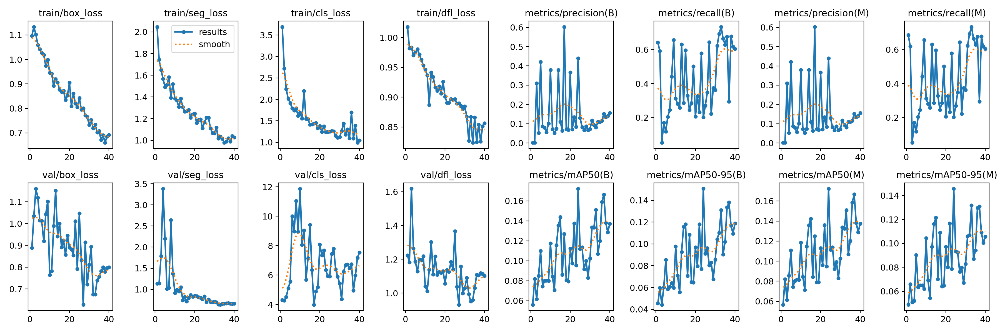

In [14]:
from IPython.display import Image as IPyImage

IPyImage(filename='/content/runs/segment/train/results.png', width=800)

Y al observar estas gráficas vemos que convergen a valores muy cercanos tanto en entrenamiento como en validación y por tanto podemos concluir que el modelo afinado generaliza bastante bien.

## 5. Generación de predicciones con el modelo afinado

Y por último, podemos usar el set de prueba (disponible en la carpeta `../datasets/masas_agua/images/test`) para generar predicciones sobre nuevos datos usando el modelo afinado.

Comencemos cargando el modelo afinado:

In [15]:
model = YOLO('/content/runs/segment/train/weights/best.pt')

Y ahora generemos predicciones sobre la totalidad del set de prueba:

In [16]:
preds = model('/content/datasets/images/test')


image 1/47 /content/datasets/images/test/aug_0_1_img-169.jpg: 640x288 1 Verde, 1 Casi, 100.0ms
image 2/47 /content/datasets/images/test/aug_108_1_frame_0013.jpg: 640x384 4 Verdes, 87.1ms
image 3/47 /content/datasets/images/test/aug_121_4_img-127.jpg: 640x288 2 Cultivables, 1 Casi, 17.8ms
image 4/47 /content/datasets/images/test/aug_125_0_frame_0219.jpg: 640x384 1 Verde, 61.7ms
image 5/47 /content/datasets/images/test/aug_127_1_img-108.jpg: 640x288 3 Verdes, 47.1ms
image 6/47 /content/datasets/images/test/aug_12_0_frame_0015.jpg: 640x384 4 Verdes, 39.3ms
image 7/47 /content/datasets/images/test/aug_130_1_frame_0110.jpg: 640x384 1 Verde, 45.1ms
image 8/47 /content/datasets/images/test/aug_131_2_img-17.jpg: 640x288 1 Verde, 35.0ms
image 9/47 /content/datasets/images/test/aug_131_4_img-17.jpg: 640x288 1 Verde, 112.8ms
image 10/47 /content/datasets/images/test/aug_136_1_frame_0213.jpg: 640x384 2 Cultivables, 68.9ms
image 11/47 /content/datasets/images/test/aug_138_4_img-251.jpg: 640x480 1 

Y para ver las predicciones generadas modemos simplemente acceder a una predicción individual y usar el método "show" para dibujar la imagen junto con la máscara de segmentación predicha:

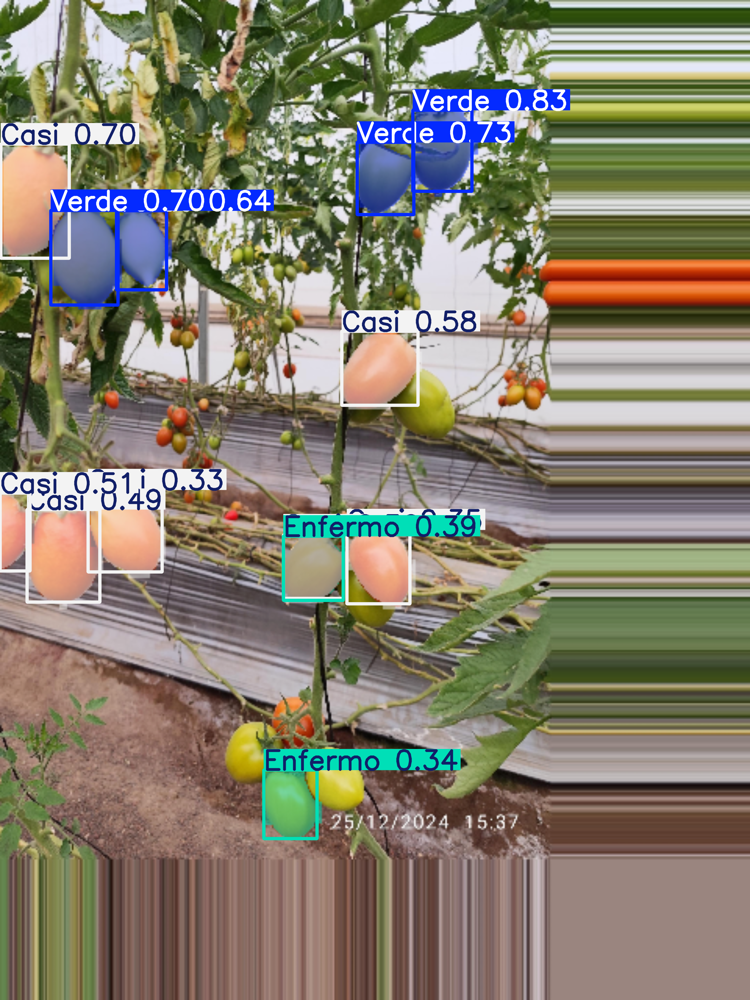

In [17]:
# Imágenes con buenas segmentaciones: 13, 150, 134
preds[20].show()

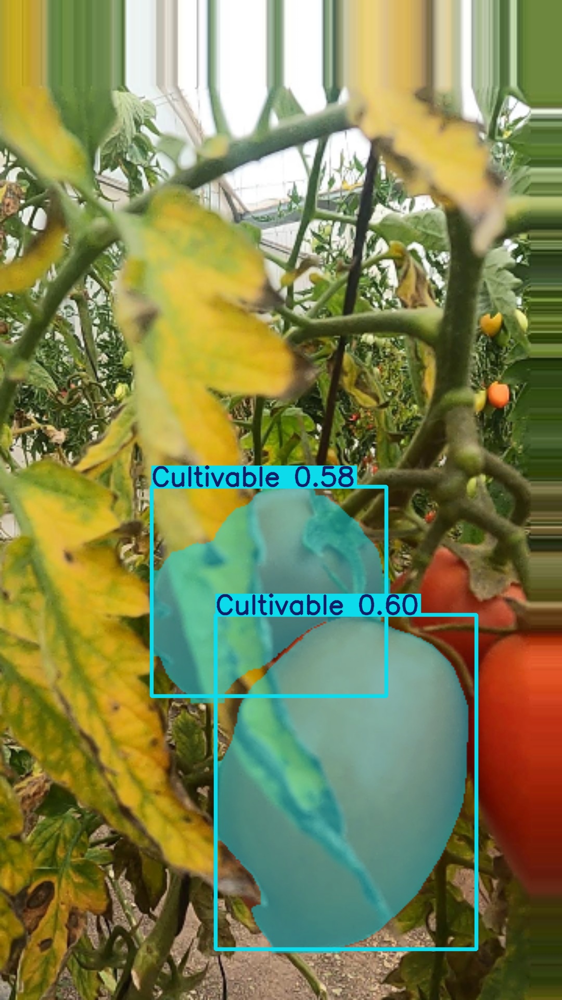

In [20]:
# Imágenes con buenas segmentaciones: 13, 150, 134
preds[9].show()

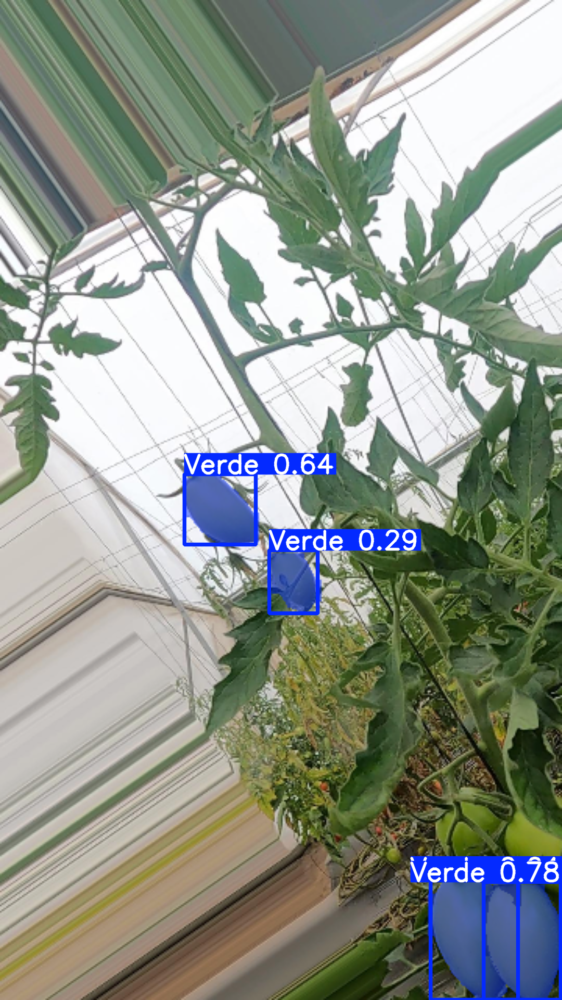

In [21]:
# Imágenes con buenas segmentaciones: 13, 150, 134
preds[1].show()

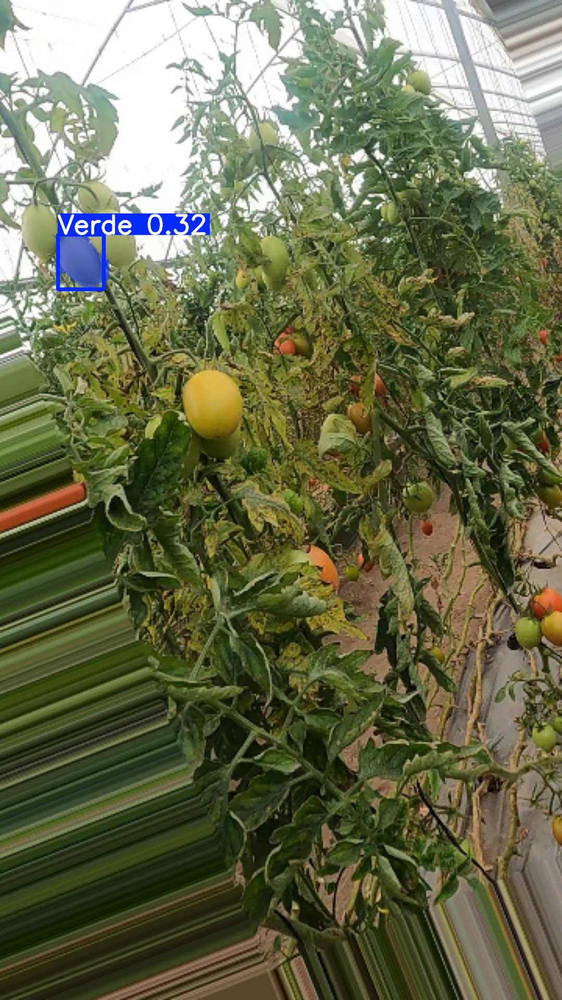

In [22]:
# Imágenes con buenas segmentaciones: 13, 150, 134
preds[3].show()

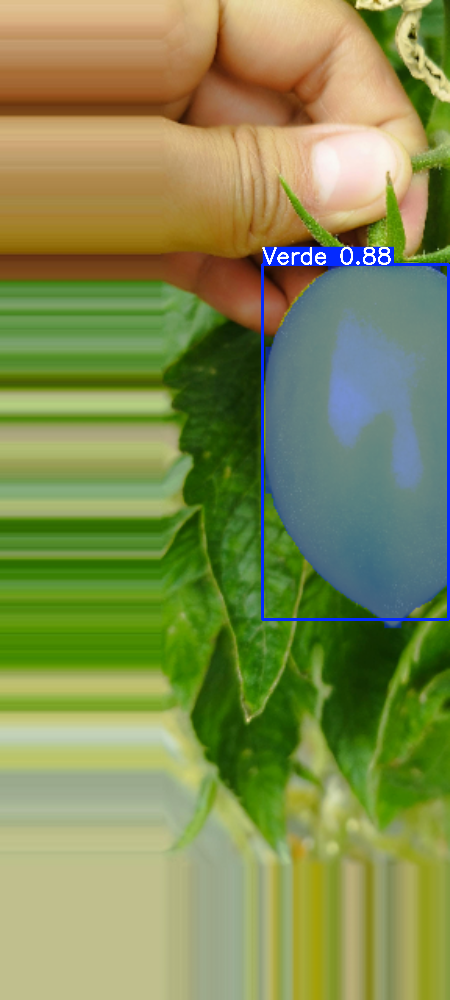

In [23]:
# Imágenes con buenas segmentaciones: 13, 150, 134
preds[8].show()

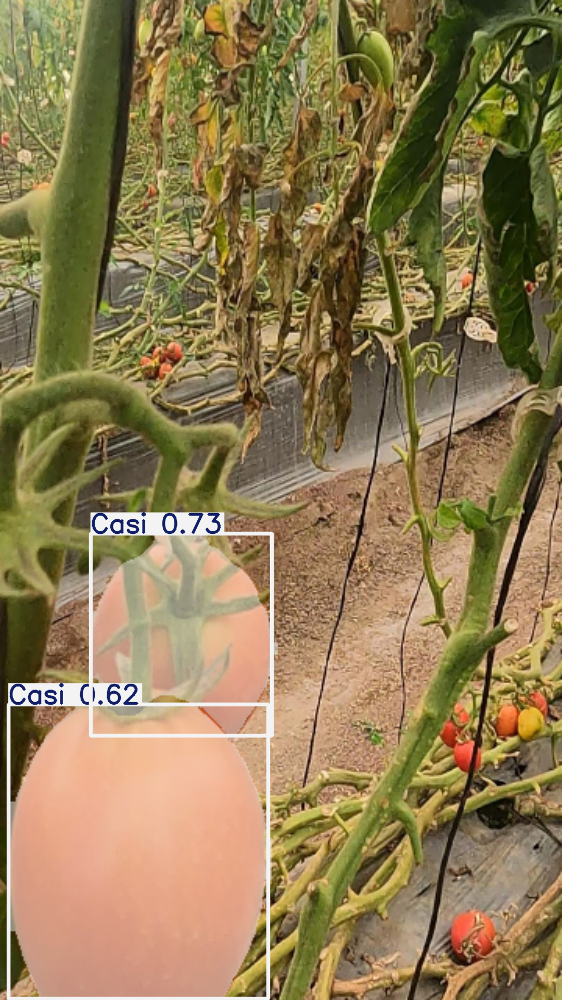

In [24]:
# Imágenes con buenas segmentaciones: 13, 150, 134
preds[32].show()